
# Manifold Modeling of Pentagon Spaces Using Laplacian Eigenfunctions

## Introduction :

A pentagon $p$ is a vector $(z_1,z_2,z_3,z_4,z_5)\in\mathbb{C}^5$ such that $d_i=|z_{i+1}-z_i|>0, \forall 1\leq i\leq 4$ where $z_6=z_1$.

Let $(d_1,d_2,d_3,d_4,d_5)\in\mathbb{R}^5$. The moduli space of pentagons with side lengths $(d_1,d_2,d_3,d_4,d_5)$ is the quotient 

$$\mathcal M_5(d_1,d_2,d_3,d_4,d_5):=\{p=(z_1,z_2,z_3,z_4,z_5)\in\mathbb{C}^5\mid d_i=|z_{i+1}-z_i|>0, \forall 1\leq i\leq 5,\}/\sim$$ 

where $z_6=z_1$. The equivalence relation $\sim$ is defined as follows: $p=(z_1,z_2,z_3,z_4,z_5),p'=(z'_1,z'_2,z'_3,z'_4,z'_5)$ are equivalent if and only if there exists $a,b\in C$ with $|a|=1$ such that $z_i=az'_i+b,\forall 1\leq i\leq 5$.

Klaus and Kojima prove that the space of pentagons is a closed smooth 2-manifold. However, depending on the choice of edge lengths, the moduli space will change topologically. Thus, the need to properly sample $\mathcal M_5(d_1,d_2,d_3,d_4,d_5)$ comes into play. Additionally, $\mathcal M_5(d_1,d_2,d_3,d_4,d_5) \subseteq \mathbb{C}^5$. For different moduli spaces, we know the surface they create: genus 3 surface or a sphere. These lie in higher dimensions and since we cannot view such high dimensional data directly, we use several tools to appriately reduce the dimension of our data and preserve topological data. 

These tools start with topological dimensionality reduction via DREiMac and then an unfolding onto a surfaces planar model. A final visualization uses the Moore-Penrose pseudo-inverse which models a best-fit manifold for our data.

## Sampling the Space of Pentagons

In this section, we define the functions needed to create a function that inputs the lengths of our pentagon, $d= [d_1, d_2, d_3, d_4]$ and will output a sampled space of pentagons.

In [1]:
import numpy as np
import math

def get_intersections(x0, y0, r0, x1, y1, r1, n=10):#find intersection points of two circles
    # circle 1: (x0, y0), radius r0
    # circle 2: (x1, y1), radius r1

    d=math.sqrt((x1-x0)**2 + (y1-y0)**2)

    #change the following nones to be more descriptive

    # non intersecting
    if d > r0 + r1 :
        print('non intersecting')
        return 'non intersecting'
    # One circle within other
    if d < abs(r0-r1):
        print('inscribed')
        return 'inscribed'
    # coincident circles
    if d == 0 and r0 == r1:
        points=[]
        for i in range(math.ceil(n*0.01)):
            points.append(x0+r0*np.cos(i*2*math.pi*(1/math.ceil(n*0.01))),y0+r0*np.sin(i*2*math.pi*(1/math.ceil(n*0.01))))
        return points
    else:
        a=(r0**2-r1**2+d**2)/(2*d)
        h=math.sqrt(r0**2-a**2)
        x2=x0+a*(x1-x0)/d
        y2=y0+a*(y1-y0)/d
        x3=x2+h*(y1-y0)/d
        y3=y2-h*(x1-x0)/d

        x4=x2-h*(y1-y0)/d
        y4=y2+h*(x1-x0)/d

        return [[x3, y3], [x4, y4]]

In [2]:
def pentagon(z3, dist): #z3 in numpy array form
    if np.linalg.norm(z3-np.array([1,0]))>dist[0]+dist[1] or np.linalg.norm(z3)>dist[2]+dist[3]:
        print(z3)
        raise Exception('z3 out of range')

    z2s=get_intersections(z3[0], z3[1], dist[1], 1, 0, dist[0])
    z4s=get_intersections(z3[0], z3[1], dist[2], 0, 0, dist[3])

    output=[]
    for i in z2s:
        for j in z4s:
            if type(j)==str or type(i)==str:
                continue
            output.append([[1,0],i,z3,j,[0,0]])
            output.append([[1,0],[i[0],-1*i[1]],[z3[0],-1*z3[1]],[j[0],-1*j[1]],[0,0]])
    return np.asarray(output,dtype=object)    

In [3]:
def moduli_space_sample(n, dist):
    if dist[2]+dist[3]>=(1+dist[0]+dist[1]):
        x_vals=np.linspace(1-(dist[0]+dist[1]),1+dist[0]+dist[1],math.ceil(math.sqrt(n//2)))
        y_vals=np.linspace(-(dist[0]+dist[1]),dist[0]+dist[1],math.ceil(math.sqrt(n//2)))
    elif -(dist[2]+dist[3])>=1-(dist[0]+dist[1]):
        x_vals=np.linspace(-(dist[2]+dist[3]),dist[2]+dist[3],math.ceil(math.sqrt(n//2)))
        y_vals=np.linspace(-(dist[2]+dist[3]),dist[2]+dist[3],math.ceil(math.sqrt(n//2)))
    elif dist[2]+dist[3]<(1+dist[0]+dist[1]) or -(dist[2]+dist[3])<1-(dist[0]+dist[1]):
        x_vals=np.linspace(1-(dist[0]+dist[1]),dist[2]+dist[3],math.ceil(math.sqrt(n//2)))
        intersections=get_intersections(0,0,dist[2]+dist[3],1,0,dist[0]+dist[1])
        if 0<intersections[0][0]<1:
            ymax, ymin = max(intersections[0][1],intersections[1][1]), min(intersections[0][1],intersections[1][1])
        elif intersections[0][0]<=0:
            ymax, ymin = dist[2]+dist[3], -(dist[2]+dist[3])
        elif intersections[0][0]>=1:
            ymax, ymin = dist[0]+dist[1], -(dist[0]+dist[1])
        y_vals=np.linspace(ymin,ymax,math.ceil(math.sqrt(n//2)))

    coords=[np.array([x,y]) for x in x_vals for y in y_vals]

    output=[]
    for i in coords:
        if np.linalg.norm(i-np.array([1,0]))<=dist[0]+dist[1] and np.linalg.norm(i)<=dist[2]+dist[3]:
            for pent in pentagon(i,dist):
                output.append(pent)

    return np.asarray(output,dtype=object)

The following code allows one to create a sample space of pentagons. Note here that names are customizable and it assumes the existence of a data file in your working directory.

In [9]:
# import xlwt
# import xlrd
# from xlwt import Workbook

# r=moduli_space_sample(14000, [0.1,0.1,0.4,0.7])

# wb = Workbook()
# sheet1 = wb.add_sheet('Sheet 1')

# def clean(i):
#     return (str(np.array(i[0]).tolist())+', '+str(np.array(i[1]).tolist())).replace('[','').replace(']','')

# for count1, pent in enumerate(r):
#     for count2, i in enumerate(pent):
#         sheet1.write(count1, count2, clean(i))

# wb.save('data.xls')


# workbook = xlrd.open_workbook(r'data.xls')
# worksheet = workbook.sheet_by_name('Sheet 1')

# with open('data/data clean.txt', 'w+') as f:
#     for i in range(worksheet.nrows-1):
#         for j in range(4):
#             f.write(worksheet.cell(i, j).value)
#             f.write(', ')
#         f.write(worksheet.cell(i, 4).value)
#         f.write('\n')


## Example Surfaces:
The found edge lengths were taken from Klaus and Kojima's paper.

The following demos follow the format:
1. Upload the data from a file
2. Run the data through Ripser and display the persistence diagrams
3. Determine the energy values of the pentagons, where the energy values measures how entangling a pentagon is
4. (Optional) Run the data through PCA (Principal Component Analysis) which projects our data onto a best chosen hyperplane. This is done in the case where the visual gives indication of the surface we are claiming to generate.

In [4]:
from ripser import ripser
from persim import plot_diagrams
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import plotly.graph_objects as go
%matplotlib inline
from dreimac import CircularCoords, GeometryExamples, PlotUtils, CircleMapUtils, ComplexProjectiveCoords, ProjectiveMapUtils, GeometryUtils


## Genus 4 Surface: $d = [1, 1, 1, 1, 1]$

In [5]:
penta1 = np.loadtxt('data/M5_clean.txt', delimiter=',')

Genus 4 Surface
Persistence of top 10 1-d features:
 [1.42 1.41 1.08 1.08 1.08 1.07 1.03 1.02 0.33 0.29] 

Persistence of top 10 2-d features:
 [0.84 0.08 0.07 0.07 0.06 0.05 0.05 0.04 0.04 0.04]


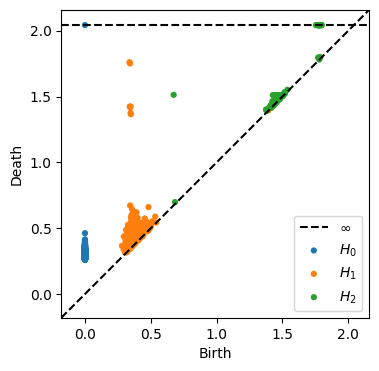

In [6]:
n_land = 900
res = ripser(penta1, n_perm = n_land, maxdim=2, coeff =13, thresh = 1.8)
dgms = res['dgms']
fig = plt.figure(figsize = (4,4))
plot_diagrams(dgms)

pers1 = dgms[1][:,1] - dgms[1][:,0]
pers2 = dgms[2][:,1] - dgms[2][:,0]

pers1_sorted = np.sort(pers1)[::-1]
pers2_sorted = np.sort(pers2[pers2 < np.Inf])[::-1]
print('Genus 4 Surface')
print('Persistence of top 10 1-d features:\n', np.around(pers1_sorted[0:10],decimals=2), '\n')
print('Persistence of top 10 2-d features:\n', np.around(pers2_sorted[0:10],decimals=2))

In [7]:
angle_data_genus4 = np.zeros((penta1.shape[0],5)) # internal angles

for i in range(5):
    ii = (2*i -2)%10
    jj = (2*i - 1)%10
    u = penta1[:, [ii, jj]]
    
    ii = (2*i)%10
    jj = (2*i + 1)%10
    v = penta1[:, [ii , jj]]
    
    ii = (2*i + 2)%10
    jj = (2*i + 3)%10
    w = penta1[:, [ii, jj]]
    
    z = np.sum((u - v)*(w-v), axis = 1)
    
    angle_data_genus4[:,i]  = np.arccos( np.minimum(z,1) )
    
energy_genus4 = np.sum((angle_data_genus4 - (3/5)*np.pi)**2 , axis = 1)

## Sphere: $d = [0.4, 0.4, 0.4, 0.4, 1]$

In [8]:
penta2 = np.loadtxt('data/sphere_clean.txt', delimiter=',')

Sphere
Persistence of top 10 2-d features:
 [0.85 0.08 0.04 0.02 0.01]


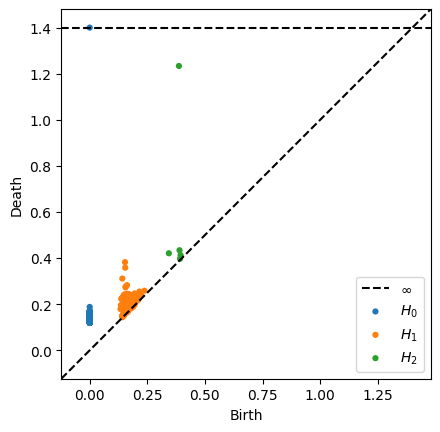

In [9]:
P = penta2
dist_mat, pointcloud_permutation = GeometryUtils.landmark_geodesic_distance(P, 300, 20)
cpc = ComplexProjectiveCoords(dist_mat, n_landmarks=300, distance_matrix=True)
fig = plt.figure()
plot_diagrams(cpc.dgms_)

pers2 = cpc.dgms_[2][:,1] - cpc.dgms_[2][:,0]

pers2_sorted = np.sort(pers2[pers2 < np.Inf])[::-1]
print('Sphere')
print('Persistence of top 10 2-d features:\n', np.around(pers2_sorted[0:10],decimals=2))

In [10]:
angle_data_sphere = np.zeros((penta2.shape[0],5)) # internal angles

for i in range(5):
    ii = (2*i -2)%10
    jj = (2*i - 1)%10
    u = penta2[:, [ii, jj]]
    
    ii = (2*i)%10
    jj = (2*i + 1)%10
    v = penta2[:, [ii , jj]]
    
    ii = (2*i + 2)%10
    jj = (2*i + 3)%10
    w = penta2[:, [ii, jj]]
    
    z = np.sum((u - v)*(w-v), axis = 1)
    
    angle_data_sphere[:,i]  = np.arccos( np.minimum(z,1) )
    
energy_sphere = np.sum((angle_data_sphere - (3/5)*np.pi)**2 , axis = 1)

In [11]:
#PCA
pca = PCA(n_components=5)
data_pca = pca.fit(penta2).transform(penta2)

print('Explained Variance', pca.explained_variance_ratio_)

fig = go.Figure(data=[go.Scatter3d(
    x=data_pca[:,0], y=data_pca[:,1], z=data_pca[:,2], 
    mode ='markers', 
    marker=dict(size = 3, color =energy_sphere, colorscale='plasma' , opacity = 1)
)])

fig.update_layout(autosize=False, width=700, height=700)  

fig.show()

Explained Variance [0.49782957 0.18898558 0.12914586 0.10464718 0.05133602]


## Genus 2 Surface: $d = [0.1, 0.1, 0.4, 0.7, 1]$

In [12]:
penta3 = np.loadtxt('data/mystery1 clean.txt', delimiter=',')

Persistence of top 10 1-d features:
 [0.14 0.14 0.11 0.1  0.04 0.03 0.03 0.03 0.03 0.02] 

Persistence of top 10 2-d features:
 [0.07 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.  ]


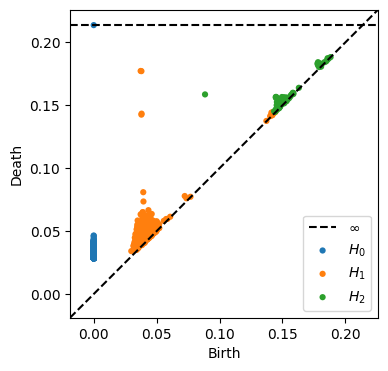

In [13]:
n_land = 900
res = ripser(penta3, n_perm = n_land, maxdim=2, coeff =13, thresh = 1.8)
dgms = res['dgms']
fig = plt.figure(figsize = (4,4))
plot_diagrams(dgms)

pers1 = dgms[1][:,1] - dgms[1][:,0]
pers2 = dgms[2][:,1] - dgms[2][:,0]

pers1_sorted = np.sort(pers1)[::-1]
pers2_sorted = np.sort(pers2[pers2 < np.Inf])[::-1]

print('Persistence of top 10 1-d features:\n', np.around(pers1_sorted[0:10],decimals=2), '\n')
print('Persistence of top 10 2-d features:\n', np.around(pers2_sorted[0:10],decimals=2))

In [14]:
angle_data_genus2 = np.zeros((penta3.shape[0],5)) # internal angles

for i in range(5):
    ii = (2*i -2)%10
    jj = (2*i - 1)%10
    u = penta3[:, [ii, jj]]
    
    ii = (2*i)%10
    jj = (2*i + 1)%10
    v = penta3[:, [ii , jj]]
    
    ii = (2*i + 2)%10
    jj = (2*i + 3)%10
    w = penta3[:, [ii, jj]]
    
    z = np.sum((u - v)*(w-v), axis = 1)
    
    angle_data_genus2[:,i]  = np.arccos( np.minimum(z,1) )
    
energy_genus2 = np.sum((angle_data_genus2 - (3/5)*np.pi)**2 , axis = 1)


In [15]:
#PCA
pca = PCA(n_components=5)
data_pca = pca.fit(penta3).transform(penta3)

print('Explained Variance', pca.explained_variance_ratio_)

fig = go.Figure(data=[go.Scatter3d(
    x=data_pca[:,0], y=data_pca[:,1], z=data_pca[:,2], 
    mode ='markers',
    marker=dict(size = 3, color = energy_genus2, colorscale='plasma' , opacity = 1)
)])

fig.update_layout(autosize=False, width=700, height=700)  

fig.show()

Explained Variance [0.71039937 0.13931273 0.098517   0.02482095 0.02082192]


## Disjoint Tori: $d = [0.1, 0.1, 1, 1, 1]$

In [16]:
penta4 = np.loadtxt('data/disjoint_tori clean.txt', delimiter=',')

Persistence of top 10 1-d features:
 [0.14 0.14 0.11 0.1  0.03 0.03 0.03 0.03 0.02 0.02] 

Persistence of top 10 2-d features:
 [0.09 0.08 0.01 0.01 0.01 0.01 0.01 0.01 0.   0.  ]


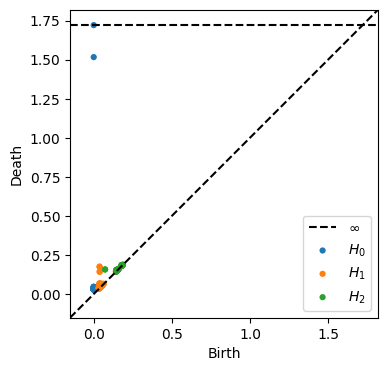

In [17]:
n_land = 900
res = ripser(penta4, n_perm = n_land, maxdim=2, coeff =13, thresh = 1.8)
dgms = res['dgms']
fig = plt.figure(figsize = (4,4))
plot_diagrams(dgms)

pers1 = dgms[1][:,1] - dgms[1][:,0]
pers2 = dgms[2][:,1] - dgms[2][:,0]

pers1_sorted = np.sort(pers1)[::-1]
pers2_sorted = np.sort(pers2[pers2 < np.Inf])[::-1]

print('Persistence of top 10 1-d features:\n', np.around(pers1_sorted[0:10],decimals=2), '\n')
print('Persistence of top 10 2-d features:\n', np.around(pers2_sorted[0:10],decimals=2))

In [18]:
angle_data = np.zeros((penta4.shape[0],5)) # internal angles

for i in range(5):
    ii = (2*i -2)%10
    jj = (2*i - 1)%10
    u = penta4[:, [ii, jj]]
    
    ii = (2*i)%10
    jj = (2*i + 1)%10
    v = penta4[:, [ii , jj]]
    
    ii = (2*i + 2)%10
    jj = (2*i + 3)%10
    w = penta4[:, [ii, jj]]
    
    z = np.sum((u - v)*(w-v), axis = 1)
    
    angle_data[:,i]  = np.arccos( np.minimum(z,1) )
    
energy_disjoint = np.sum((angle_data - (3/5)*np.pi)**2 , axis = 1)


In [19]:
#PCA
pca = PCA(n_components=5)
data_pca = pca.fit(penta4).transform(penta4)

print('Explained Variance', pca.explained_variance_ratio_)

fig = go.Figure(data=[go.Scatter3d(
    x=data_pca[:,0], y=data_pca[:,1], z=data_pca[:,2], 
    mode ='markers', 
    marker=dict(size = 3, color =energy_disjoint, colorscale='plasma' , opacity = 1)
)])

fig.update_layout(autosize=False, width=700, height=700)  

fig.show()

Explained Variance [0.94892694 0.02212991 0.01666748 0.00742138 0.0024575 ]


# Topological Dimensionality Reduction on Sampled Moduli Spaces

The following blocks will demonstrate topological dimensionality reduction being done on varying surfaces. 

## Genus 4 Surface: $d = [1, 1, 1, 1, 1]$

For genus 4, the TDR displayed is a working version that creates all four identifiable handles. In order to achieve this, we run our data through CircularCoords becasue we wish to work directly with one dimensional persistent cohomology classes. Once here, we troubleshoot different linear combinations of said persistent cohomology classes to achieve the best visualization. We repeat this process for the genus 2 surface and the disjoint tori.

In [20]:
n_lands = 1000

cc = CircularCoords(penta1 , n_landmarks= n_lands)

coho_classes = [0, 1, 2, 3]

circular_coords = []

for i in coho_classes:
    circular_coords.append(cc.get_coordinates(perc = 0.6, cocycle_idx=i, standard_range= False))

In [21]:
thetas= CircleMapUtils.linear_combination(np.array(circular_coords), [[1,1,0,0], [0,1,0,0],[0,0,1,1]])
theta1 = CircleMapUtils.center(thetas[0])
theta2 = CircleMapUtils.center(thetas[1])
theta3 = CircleMapUtils.center(thetas[2])

# Plot the data using the computed circular coordintaes, and colors given by pentagon energy
fig = go.Figure(data=[go.Scatter3d(
    x=theta1, y=theta2, z=theta3, 
    mode ='markers', 
    marker=dict(size = 3, color =energy_genus4, colorscale='plasma')
)])

fig.update_layout(autosize=False, width=900, height=900)
fig.show()

## Sphere: $d = [0.4, 0.4, 0.4, 0.4, 0.4]$

In the case of the sphere, the function CircularCoords is not applicable since spheres have no persisting one dimensional holes. Instead we use the function ComplexProjCoords to map our data into $\mathbb{C}P^\infty$ and then project onto the sphere. We see our visualization indeed resembles a sphere. We do an additional stereographic projection to make study of the data and any possible holes more accessible.

In [ ]:
coords = cpc.get_coordinates(perc=0.9, proj_dim=1)
coords_R3 = ProjectiveMapUtils.hopf_map(coords)
coords_R2 = ProjectiveMapUtils.stereographic_projection_hemispheres(coords_R3)

In [ ]:
fig = go.Figure(data=[go.Scatter3d(
    x=coords_R3[:,0], y=coords_R3[:,1], z=coords_R3[:,2], 
    mode ='markers', 
    marker=dict(size = 3, color =energy_sphere[pointcloud_permutation], colorscale='plasma' , opacity = 1)
)])

fig.update_layout(autosize=False, width=700, height=700)  
fig.show()

In [ ]:
fig = plt.figure()
plt.axis("off")
_ = PlotUtils.plot_2sphere_boundary()
plt.scatter(coords_R2[:,0], coords_R2[:,1],c=energy_sphere[pointcloud_permutation], cmap='plasma')
_ = plt.axis("equal")
fig.savefig('hemispheres.png', facecolor='w', bbox_inches='tight')

## Genus 2 Surface: $d = [0.1, 0.1, 0.4, 0.7, 1]$

For the genus 2 surface, we repeat the process done on the genus 4 sampled data. In this case, the visualization still has issues with self intersections. The hope is to get a visual without such intersections and haev 2 identified handles.

In [ ]:
n_lands = 900

cc = CircularCoords(penta3, n_landmarks= n_lands)
coho_classes = [0, 1, 2, 3]
circular_coords = []

for i in coho_classes:
    circular_coords.append(cc.get_coordinates(perc = 0.6, cocycle_idx=i, standard_range= False))
    
#Applying Circular coords and doing TDR

thetas= CircleMapUtils.linear_combination(np.array(circular_coords), [[1,0,0,0], [0,1,1,0],[0,1,1,-1], [0,0,0,1]])

theta1 = CircleMapUtils.center(thetas[0])
theta2 = CircleMapUtils.center(thetas[1])
theta3 = CircleMapUtils.center(thetas[2])
theta4 = CircleMapUtils.center(thetas[3])


# Plot the data using the computed circular coordintaes, and colors given by pentagon energy
fig = go.Figure(data=[go.Scatter3d(
    x=theta1, y=theta2, z=theta3, 
    mode ='markers', 
    marker=dict(size = 3, color =energy_genus2, colorscale='plasma')
)])

fig.update_layout(autosize=False, width=700, height=700)
fig.show()

## Disjoint Tori: $d = [0.1, 0.1, 1, 1, 1]$

Similar to genus 4, we run CiruclarCoords to work directly with the one dimensional cohomology classes of the disjoint tori. We run into similar troubles with self intersections. The hope for this visual is to have two squares with identified sides be non-intersecting, similar to the PCA of the disjoint tori.

In [ ]:
n_lands = 1000

cc = CircularCoords(penta4 , n_landmarks= n_lands)

coho_classes = [0, 1, 2, 3]

circular_coords = []

for i in coho_classes:
    circular_coords.append(cc.get_coordinates(perc = 0.6, cocycle_idx=i, standard_range= False))

thetas= CircleMapUtils.linear_combination(np.array(circular_coords), [[1,0,0,0], [0,1,0,0],[0,0,1,1], [0,1,0,1]])
theta1 = CircleMapUtils.center(thetas[0])
theta2 = CircleMapUtils.center(thetas[1])
theta3 = CircleMapUtils.center(thetas[2])

fig = go.Figure(data=[go.Scatter3d(
    x=theta1, y=theta2, z=theta3, 
    mode ='markers', 
    marker=dict(size = 3, color =energy_disjoint, colorscale='plasma')
)])

fig.update_layout(autosize=False, width=900, height=900)

fig.show()

# Unfolding the Surface of Pentagons

In this section, we will be working with generated torus data. 

In [ ]:
from sklearn.neighbors import NearestNeighbors
from scipy.sparse import csr_matrix
from plotly.subplots import make_subplots
from scipy.sparse.csgraph import shortest_path
from sklearn import manifold

## DREiMac Torus

Below is the 3D visualization of our data. We run our torus data through the CircularCoords algorithm as well to identity the top two peristent cohomology classes. They are displayed below. Note how both trace our circles along the dark blue and yellow divide.

In [ ]:
np.random.seed(2)
n_data = 2500
R = 5
r = 2
data = np.zeros((n_data, 3))
s = np.random.rand(n_data)*2*np.pi
t = np.random.rand(n_data)*2*np.pi

data[:, 0] = (R + r*np.cos(s))*np.cos(t)
data[:, 1] = (R + r*np.cos(s))*np.sin(t)
data[:, 2] = r*np.sin(s)
data += 0.1*np.random.randn(*data.shape)

# Plot the data 
fig = go.Figure(data=[go.Scatter3d(
    x=data[:,0], y=data[:,1], z=data[:,2], 
    mode ='markers', 
    marker=dict(size = 1.5 , color = 'navy'))])

fig.update_layout( showlegend=False )
fig.show(renderer='iframe')

In [ ]:
n_lands = 200

cc = CircularCoords(data, n_landmarks=n_lands)
coho_classes = [0, 1]
circular_coords = []

for i in coho_classes:
    theta = cc.get_coordinates(perc= 0, cocycle_idx=i)
    theta = CircleMapUtils.center(theta)
    circular_coords.append(theta)

In [ ]:
fig = make_subplots(rows=1, cols=len(coho_classes), 
                    subplot_titles = tuple('Circ Coord '+str(i+1) for i in coho_classes),
                    specs = [[{'type': 'scatter3d'} for i in coho_classes]])

for i, coord in enumerate(circular_coords):
    fig.add_trace(
        go.Scatter3d(x=data.T[0], y=data.T[1], z=data.T[2],   mode ='markers', 
        marker=dict(size = 2 , color =  circular_coords[i])),  
        row=1, col=i+1)
    fig.update_scenes(xaxis=dict( ticks='', showticklabels=False), 
                      yaxis=dict( ticks='', showticklabels=False), 
                      zaxis=dict( ticks='', showticklabels=False), 
                      aspectmode='data', row=1, col=i+1)

fig.update_layout( showlegend=False )
fig.show(renderer='iframe')

In [ ]:
#take in cuts as a list of circular coordinate arrays

cuts=[circular_coords[0],circular_coords[1]]

#calculate the k nearest neighbors graph

n_land = 900
k_neigh = 20
nbrs = NearestNeighbors(n_neighbors=k_neigh, algorithm='ball_tree').fit(data)
distances, indices = nbrs.kneighbors(data)

#the output is a list of pairs of ndarrays that has length n_data. For any row (each representing a point),
#the first element of the pair is the indices in the data for the k nearest points
#and the second element is the distance between each point and the current row (point).
simplicial_complex=[[indices[i],distances[i]] for i in range(len(indices))]

In [ ]:
#this function makes cuts and takes in a list of circular coords arrays as well as a neighbor graph and outputs a cut graph
def cut_neighbors(cuts, neighbor_graph):
    removals=0
    for ind, point in enumerate(neighbor_graph):
        counts=[]
        for count, i in enumerate(point[0]):
            if any(np.abs(cut[ind]-cut[i]) > np.pi for cut in cuts):
                counts.append(count)
                removals+=1
        neighbor_graph[ind][0]=np.delete(neighbor_graph[ind][0],counts)
        neighbor_graph[ind][1]=np.delete(neighbor_graph[ind][1],counts)
    print('Removals: ',removals)
    return neighbor_graph

new_neighbor_graph=cut_neighbors(cuts, simplicial_complex)

In [ ]:
#now we transform our cut up graph into a numpy distance matrix and then a compressed sparse matrix
#we can do this because out neighbors graph contained distance data in it

kneighbors_graph=np.zeros((n_data,n_data))
for count, info in enumerate(simplicial_complex):
    for place, ind in enumerate(info[0]):
        kneighbors_graph[count,ind]=info[1][place]
kneighbors_graph=csr_matrix(kneighbors_graph)

In [ ]:
#calculating geodesic distance matrix

n_landmarks=800

n_points = data.shape[0]
perm = np.zeros(n_landmarks, dtype=np.int64)
lambdas = np.zeros(n_landmarks)
ds = shortest_path(kneighbors_graph, indices=0, directed=False)
D = np.zeros((n_landmarks, n_points))
D[0, :] = ds
for i in range(1, n_landmarks):
    idx = np.argmax(ds)
    perm[i] = idx
    lambdas[i] = ds[idx]
    thisds = shortest_path(kneighbors_graph, indices=idx, directed=False)
    D[i, :] = thisds
    ds = np.minimum(ds, thisds)

perm_rest_points = np.setdiff1d(
np.arange(0, n_points, dtype=int), perm, assume_unique=True
)
perm_all_points = np.concatenate((perm, perm_rest_points))

dist_landmarks_points = D[:, perm_all_points]

In [ ]:
#check that the distance matrix has no infinity values

inf_in_mat=[]
for i in dist_landmarks_points:
    inf_in_mat.append(list(np.isinf(i)).count(True)==0)

print('Distance matrix has no infinity values: ',all(inf_in_mat))

Below is the image of our unfolded torus after making incisions along both of our cohomology classes.

In [ ]:
#using scipy to calculate the multi-dimensional scaling of the distance matrix

mds= manifold.MDS(
    n_components=2,
    metric=True,
    dissimilarity="precomputed",
    normalized_stress='auto'
)
unfolding = mds.fit_transform(dist_landmarks_points[:,0:dist_landmarks_points.shape[0]])

plt.scatter(unfolding[:, 0], unfolding[:, 1], color="navy")

# Finding a Best-Fit Manifold Using Solutions to the Laplacian

Here, we will be working with our sampled sphere data from above. Once the data is converted into spherical coordinates, we will create our approximated embedding using spherical harmonics and special choices for the matrix $U$. This outputs the finall error value which is computed via $$\sum_{x\in X}\lVert x - H \circ h(x) \rVert$$

In [ ]:
from numpy import linalg, matmul
from scipy import special
def angle_from_side(a, b, c):#law of cosines for sides a,b,c returning angle C
    
    cos_c = (a **2 + b ** 2 - c ** 2)/(2*a*b)
    C = math.acos(cos_c)
    return C

## Sphere: $d = [0.4, 0.4, 0.4, 0.4, 0.4]$

In [ ]:
sphericalcoords = []
for i in coords_R3:
    r = math.sqrt((i[0])**2 + (i[1])**2 + (i[2])**2)
    w = math.sqrt((-i[0])**2 + (i[1])**2)
    theta = math.acos((i[2])/r)
    phi = angle_from_side(i[0], i[1], w)
    sphericalcoords.append([r, theta, phi])

In [ ]:
D = penta2.shape[0]
N = 85
A = []

for i in range(D):
    for j in range(N):
        A.append(special.sph_harm(j+1, N, sphericalcoords[i][1], sphericalcoords[i][2]))
A = np.array(A)
A = A.reshape(D,N)

In [ ]:
#Compute inverse
A_inv = linalg.pinv(A)
u = matmul(A_inv, sphericalcoords)

In [ ]:
error = (linalg.norm(sphericalcoords - matmul(A, u)))
error = error/penta1.shape[0]
print(error)